In [ ]:
from PIL import Image
from skimage import io
from pathlib import Path
import scipy
import skimage.color as color
import skimage
import pandas as pd
import cv2
import numpy as np
import os
import csv
import imageio
from matplotlib import pyplot as plt
from pandas import DataFrame
import scipy.ndimage as ndi

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Create Function**

Shape normalization function

In [ ]:
def normalize_img(image):
    # convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # normalize the pixel intensities to be between 0 and 1
    normalized_img = gray / 255.0

    return normalized_img

def crop_img(image):
    # normalize the image pixel intensities
    normalized_img = normalize_img(image)

    # apply thresholding to the normalized image
    threshold_value = 0.1
    _, mask = cv2.threshold(normalized_img, threshold_value, 1, cv2.THRESH_BINARY)

    # find the coordinates of the non-zero elements in the mask
    coords = np.argwhere(mask)

    # find the smallest and largest coordinates in each dimension
    x = np.min(coords, axis=0)
    y = np.max(coords, axis=0) + 1

    # crop the image based on the smallest and largest coordinates
    cropped_img = image[x[0]:y[0], x[1]:y[1]]

    return cropped_img

Color Normalization Function

In [ ]:
#calculating RGB
color_norm = "drive/My Drive/Tugas Akhir/DATASETS/Color Normalization"
#listing files in images folder
list_img = os.listdir(color_norm)
#iterating over color_norm to get the images as arrays
r = 0
g = 0
b = 0
for image in sorted(list_img):
    [file_name, ext] = os.path.splitext(image)
    arr = np.array(Image.open(os.path.join(color_norm, image))) #creating arrays for all the images
    [h, w] = np.shape(arr)[0:2]#calculating height and width for each image
    arr_dim = arr.ndim #calculating the dimension for each array
    arr_shape = arr.shape #calculating the shape for each array
    arr_mean = np.mean(arr, axis=(0,1)) #calculating mean value of each channel
    len(arr_mean) == 3 #RGB
    print(f'[{file_name}, R={arr_mean[0]:.1f}, G={arr_mean[1]:.1f}, B={arr_mean[2]:.1f}]')
    r += arr_mean[0]/len(list_img)
    g += arr_mean[1]/len(list_img)
    b += arr_mean[2]/len(list_img)
print('Rata-rata : r*={}  g*={}  b*={}'.format(r,g,b))

def color_norm(image_norm):
  pixels = np.array(image_norm)
  ar_mean = np.mean(pixels, axis=(0,1))
  Ri = pixels[:,:,0]
  Gi = pixels[:,:,1]
  Bi = pixels[:,:,2]
  (H,W) = pixels.shape[:2]

  for x in range(H):
    for y in range(W):
      if ar_mean[0] != 0:
          val = np.min(Ri[x, y] / float(ar_mean[0]) * float(r))
          Ri[x, y] = 255 if val > 255 else val
      if ar_mean[1] != 0:
          val = np.min(Gi[x, y] / float(ar_mean[1]) * float(g))
          Gi[x, y] = 255 if val > 255 else val
      if ar_mean[2] != 0:
          val = np.min(Bi[x, y] / float(ar_mean[2]) * float(b))
          Bi[x, y] = 255 if val > 255 else val

  merged = np.dstack((Ri,Gi,Bi))
  return merged

[IDRiD_001, R=121.1, G=59.5, B=8.1]
[IDRiD_002, R=119.2, G=58.6, B=8.6]
[IDRiD_013, R=138.3, G=68.0, B=8.2]
[IDRiD_027, R=138.9, G=66.0, B=15.7]
[IDRiD_028, R=122.2, G=54.1, B=26.9]
[IDRiD_03, R=123.9, G=62.0, B=21.0]
[IDRiD_030, R=111.9, G=64.2, B=25.7]
[IDRiD_035, R=112.6, G=55.5, B=12.0]
[IDRiD_038, R=135.5, G=74.4, B=37.2]
[IDRiD_039, R=116.8, G=55.0, B=11.4]
[IDRiD_040, R=120.0, G=58.0, B=12.8]
[IDRiD_055, R=117.0, G=66.3, B=28.2]
[IDRiD_056, R=110.7, G=58.8, B=19.4]
[IDRiD_060, R=141.5, G=82.2, B=43.0]
[IDRiD_061, R=141.5, G=82.2, B=43.0]
[IDRiD_079, R=111.6, G=50.2, B=6.5]
[IDRiD_08, R=135.8, G=73.2, B=19.4]
[IDRiD_080, R=109.8, G=51.8, B=6.5]
[IDRiD_091, R=107.6, G=48.5, B=4.0]
[IDRiD_101, R=120.3, G=57.0, B=17.2]
[IDRiD_105, R=112.7, G=53.9, B=8.4]
[IDRiD_117, R=114.1, G=53.2, B=10.9]
[IDRiD_12, R=114.0, G=53.7, B=8.8]
[IDRiD_14, R=140.4, G=57.1, B=7.0]
[IDRiD_162, R=153.2, G=72.3, B=31.6]
[IDRiD_18, R=119.9, G=55.2, B=13.2]
[IDRiD_188, R=113.0, G=55.6, B=13.0]
[IDRiD_211, R=9

CLAHE function

In [ ]:
#based on PSNR clip limit=1.0, tilegrid=15x15
def contrast_enhance(img_clahe):
  clahe = cv2.createCLAHE(clipLimit= 1.0, tileGridSize=(15, 15))

  Red = img_clahe[...,0]
  Green = img_clahe[...,1]
  Blue = img_clahe[...,2]

  Green_fix = clahe.apply(Green)
  new_img = np.stack([Red, Green_fix, Blue], axis=2)
  return new_img

Performance Evaluation Function

In [ ]:
def mean_squared_error(image1, image2):
    return np.mean((image1 - image2) ** 2)

def peak_signal_noise_ratio(image1, image2):
    mse = np.mean((image1 - image2) ** 2)
    return 10 * np.log10(255 ** 2 / mse)

IDRiD DATASET

In [ ]:
#Dataset Segmentasi
idrid_segment_train = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/ORIGINAL/Training Set/*.jpg')
idrid_segment_test = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/ORIGINAL/Testing Set/*.jpg')

#Dataset Grading
idrid_grading_train_normal    = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TRAINING/Normal/*.jpg')
idrid_grading_train_mild      = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TRAINING/Mild/*.jpg')
idrid_grading_train_moderate  = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TRAINING/Moderate/*.jpg')
idrid_grading_train_severe    = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TRAINING/Severe/*.jpg')
idrid_grading_train_pdr       = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TRAINING/Proliferative DR/*.jpg')

idrid_grading_test_normal     = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TESTING/Normal/*.jpg')
idrid_grading_test_mild       = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TESTING/Mild/*.jpg')
idrid_grading_test_moderate   = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TESTING/Moderate/*.jpg')
idrid_grading_test_severe     = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TESTING/Severe/*.jpg')
idrid_grading_test_pdr        = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID GRADING/TESTING/Proliferative DR/*.jpg')

# Preprocess Dataset

**Normal**

,MSE,PSNR
0,64.680299,30.023083
1,69.535453,29.708741
2,71.261503,29.602254
3,71.033532,29.616169
4,80.872322,29.052804
...,...,...
130,53.562519,30.842194
131,100.082556,28.127220
132,100.325681,28.116682
133,55.192223,30.712025


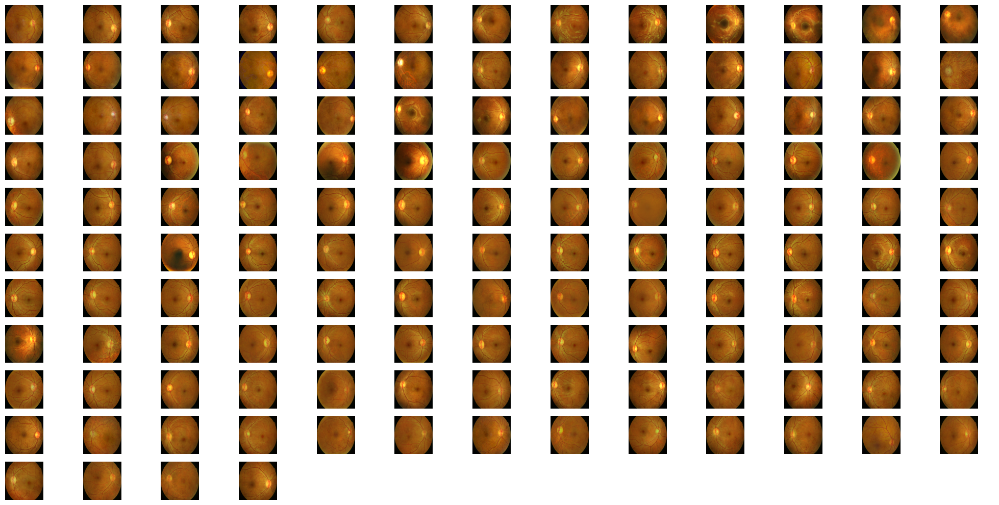

In [ ]:
#save_dir_normal = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TRAINING/NORMAL/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_normal):
#    os.makedirs(save_dir_normal)

f, axes = plt.subplots(nrows=11, ncols=13, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid2 = []
PSNR_idrid2 = []
for i, idrid2 in enumerate(idrid_grading_train_normal):
  idrid = crop_img(idrid2)
  idrid22 = cv2.resize(idrid, (512,512))
  idrid23 = color_norm(idrid22)
  idrid24 = contrast_enhance(idrid23)
  idrid25 = cv2.medianBlur(idrid24,3)

  # Convert numpy array to image object
  idrid26 = Image.fromarray(idrid25)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_train_normal.files[i])
  #save_path_normal = os.path.join(save_dir_normal, filename)
  #idrid26.save(save_path_normal, optimize=True, quality=90)

  MSE_idrid2.append(mean_squared_error(idrid22, idrid25))
  PSNR_idrid2.append(peak_signal_noise_ratio(idrid22, idrid25))

  axes[i].imshow(idrid25)
plt.tight_layout()

df2 = DataFrame({'MSE' :MSE_idrid2,
                'PSNR':PSNR_idrid2})

mean_mse21 = df2['MSE'].mean()
mean_psnr21 = df2['PSNR'].mean()

df2.loc[len(df2.index)] = [mean_mse21, mean_psnr21]

df2

**Mild**

,MSE,PSNR
0,105.135735,27.913300
1,77.868242,29.217200
2,54.942382,30.731729
3,83.124250,28.933526
4,35.603710,32.615851
5,99.627289,28.147020
6,67.592929,29.831791
7,82.852341,28.947756
8,68.554553,29.770441
9,77.868242,29.217200


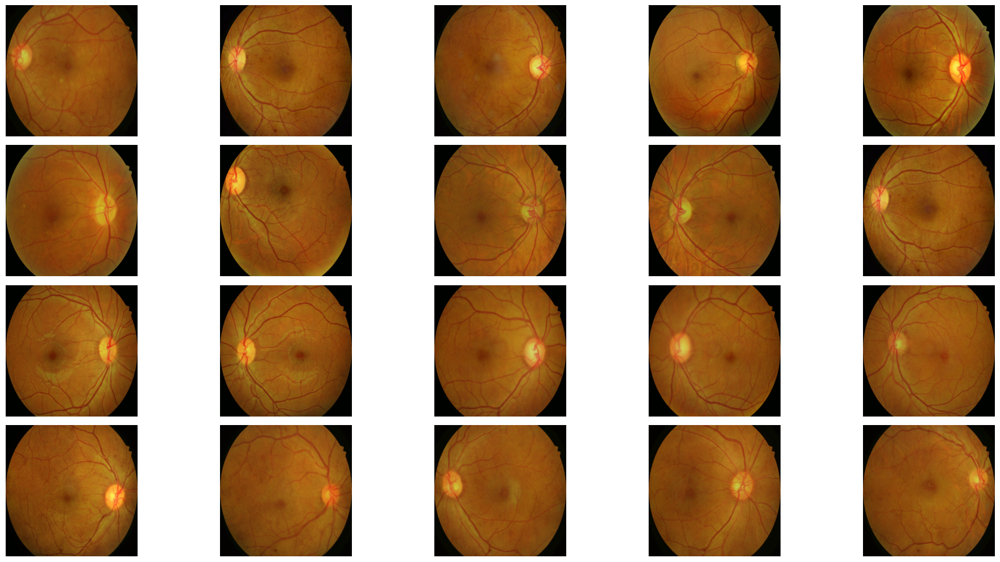

In [ ]:
#save_dir_mild = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TRAINING/MILD/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_mild):
#    os.makedirs(save_dir_mild)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid3 = []
PSNR_idrid3 = []
for i, idrid3 in enumerate(idrid_grading_train_mild):
  idrid = crop_img(idrid3)
  idrid32 = cv2.resize(idrid, (512,512))
  idrid33 = color_norm(idrid32)
  idrid34 = contrast_enhance(idrid33)
  idrid35 = cv2.medianBlur(idrid34,3)

  # Convert numpy array to image object
  idrid36 = Image.fromarray(idrid35)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_train_mild.files[i])
  #save_path_mild = os.path.join(save_dir_mild, filename)
  #idrid36.save(save_path_mild, optimize=True, quality=90)

  MSE_idrid3.append(mean_squared_error(idrid32, idrid35))
  PSNR_idrid3.append(peak_signal_noise_ratio(idrid32, idrid35))

  axes[i].imshow(idrid35)
plt.tight_layout()

df3 = DataFrame({'MSE' :MSE_idrid3,
                'PSNR':PSNR_idrid3})

mean_mse31 = df3['MSE'].mean()
mean_psnr31 = df3['PSNR'].mean()

df3.loc[len(df3.index)] = [mean_mse31, mean_psnr31]

df3

**Moderate**

,MSE,PSNR
0,90.246708,28.576490
1,81.301488,29.029819
2,65.492137,29.968912
3,80.743271,29.059740
4,104.812684,27.926665
...,...,...
132,77.415110,29.242546
133,65.745286,29.952157
134,77.391243,29.243885
135,72.507359,29.526983


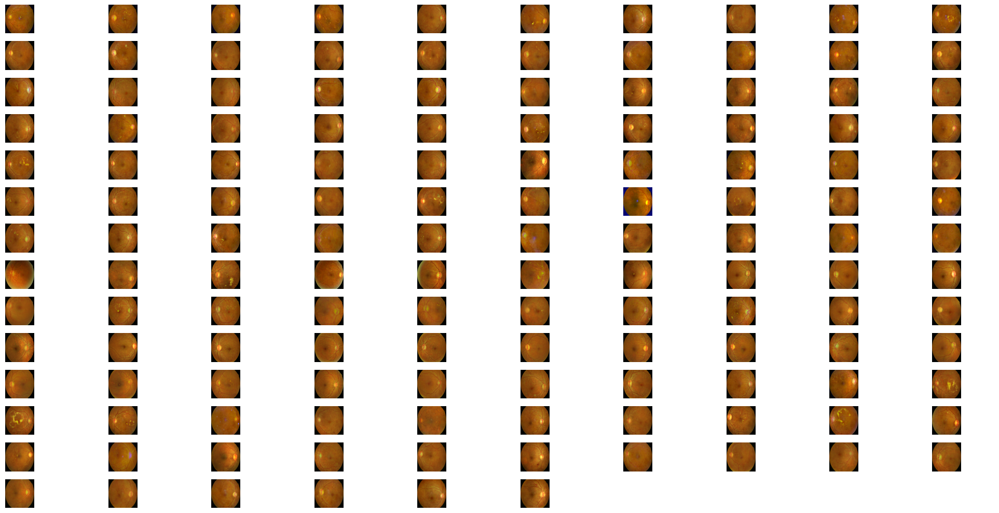

In [ ]:
#save_dir_mod = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TRAINING/MODERATE/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_mod):
#    os.makedirs(save_dir_mod)

f, axes = plt.subplots(nrows=14, ncols=10, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid4 = []
PSNR_idrid4 = []
for i, idrid4 in enumerate(idrid_grading_train_moderate):
  idrid = crop_img(idrid4)
  idrid42 = cv2.resize(idrid, (512,512))
  idrid43 = color_norm(idrid42)
  idrid44 = contrast_enhance(idrid43)
  idrid45 = cv2.medianBlur(idrid44,3)

  # Convert numpy array to image object
  idrid46 = Image.fromarray(idrid45)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_train_moderate.files[i])
  #save_path_mod = os.path.join(save_dir_mod, filename)
  #idrid46.save(save_path_mod, optimize=True, quality=90)

  MSE_idrid4.append(mean_squared_error(idrid42, idrid45))
  PSNR_idrid4.append(peak_signal_noise_ratio(idrid42, idrid45))

  axes[i].imshow(idrid45)
plt.tight_layout()

df4 = DataFrame({'MSE' :MSE_idrid4,
                'PSNR':PSNR_idrid4})

mean_mse41 = df4['MSE'].mean()
mean_psnr41 = df4['PSNR'].mean()

df4.loc[len(df4.index)] = [mean_mse41, mean_psnr41]

df4

**Severe**

,MSE,PSNR
0,65.796870,29.948751
1,59.822384,30.362166
2,21.432401,34.820095
3,75.401981,29.356976
4,89.401381,28.617361
...,...,...
70,58.301366,30.474016
71,98.372981,28.202045
72,100.186217,28.122724
73,86.162495,28.777621


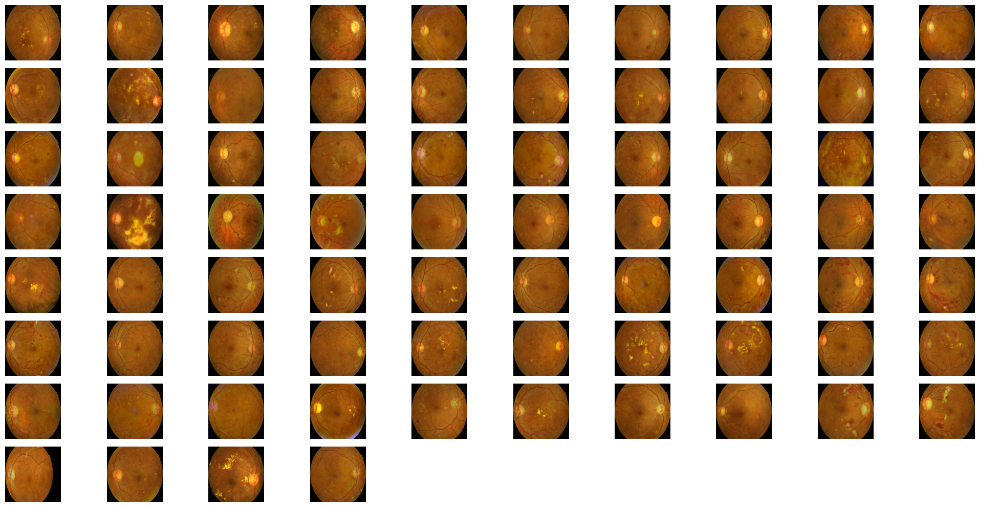

In [ ]:
#save_dir_svr = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TRAINING/SEVERE/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_svr):
#    os.makedirs(save_dir_svr)

f, axes = plt.subplots(nrows=8, ncols=10, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid5 = []
PSNR_idrid5 = []
for i, idrid5 in enumerate(idrid_grading_train_severe):
  idrid = crop_img(idrid5)
  idrid52 = cv2.resize(idrid, (512,512))
  idrid53 = color_norm(idrid52)
  idrid54 = contrast_enhance(idrid53)
  idrid55 = cv2.medianBlur(idrid54,3)

  # Convert numpy array to image object
  idrid56 = Image.fromarray(idrid55)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_train_severe.files[i])
  #save_path_svr = os.path.join(save_dir_svr, filename)
  #idrid56.save(save_path_svr, optimize=True, quality=90)

  MSE_idrid5.append(mean_squared_error(idrid52, idrid55))
  PSNR_idrid5.append(peak_signal_noise_ratio(idrid52, idrid55))

  axes[i].imshow(idrid55)
plt.tight_layout()

df5 = DataFrame({'MSE' :MSE_idrid5,
                'PSNR':PSNR_idrid5})

mean_mse51 = df5['MSE'].mean()
mean_psnr51 = df5['PSNR'].mean()

df5.loc[len(df5.index)] = [mean_mse51, mean_psnr51]

df5

**PDR**

,MSE,PSNR
0,86.673995,28.751915
1,64.355436,30.044951
2,99.632749,28.146782
3,97.550913,28.238490
4,63.752181,30.085853
5,90.973029,28.541677
6,78.725903,29.169627
7,70.616961,29.641713
8,98.740395,28.185855
9,63.779049,30.084023


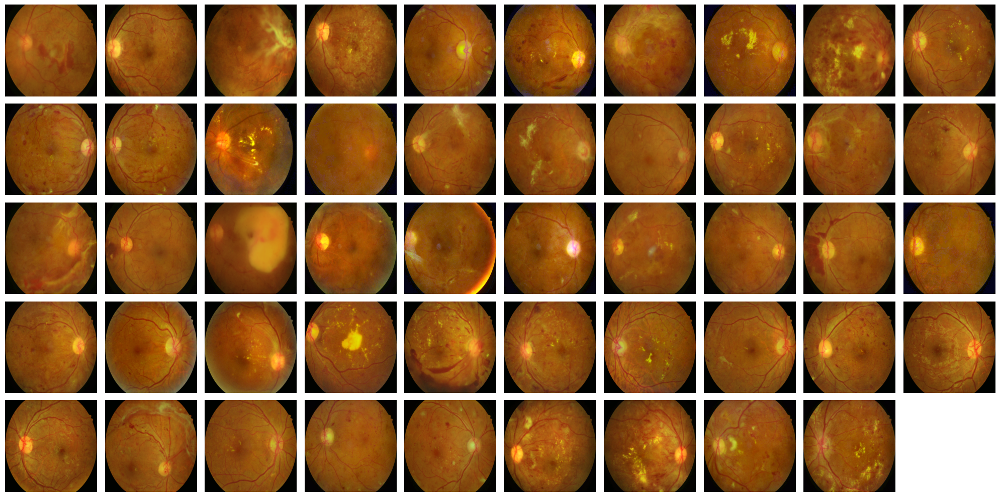

In [ ]:
#save_dir_pdr = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TRAINING/PDR/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_pdr):
#    os.makedirs(save_dir_pdr)

f, axes = plt.subplots(nrows=5, ncols=10, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid6 = []
PSNR_idrid6 = []
for i, idrid6 in enumerate(idrid_grading_train_pdr):
  idrid = crop_img(idrid6)
  idrid62 = cv2.resize(idrid, (512,512))
  idrid63 = color_norm(idrid62)
  idrid64 = contrast_enhance(idrid63)
  idrid65 = cv2.medianBlur(idrid64,3)

  # Convert numpy array to image object
  idrid66 = Image.fromarray(idrid65)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_train_pdr.files[i])
  #save_path_pdr = os.path.join(save_dir_pdr, filename)
  #idrid66.save(save_path_pdr, optimize=True, quality=90)

  MSE_idrid6.append(mean_squared_error(idrid62, idrid65))
  PSNR_idrid6.append(peak_signal_noise_ratio(idrid62, idrid65))

  axes[i].imshow(idrid65)
plt.tight_layout()

df6 = DataFrame({'MSE' :MSE_idrid6,
                'PSNR':PSNR_idrid6})

mean_mse61 = df6['MSE'].mean()
mean_psnr61 = df6['PSNR'].mean()

df6.loc[len(df6.index)] = [mean_mse61, mean_psnr61]

df6

**Normal**

,MSE,PSNR
0,109.166924,27.749893
1,95.379912,28.336234
2,79.580434,29.122741
3,90.376163,28.570265
4,88.579428,28.657475
5,102.315458,28.031391
6,84.976662,28.837807
7,76.502130,29.294068
8,85.051647,28.833976
9,70.508232,29.648405


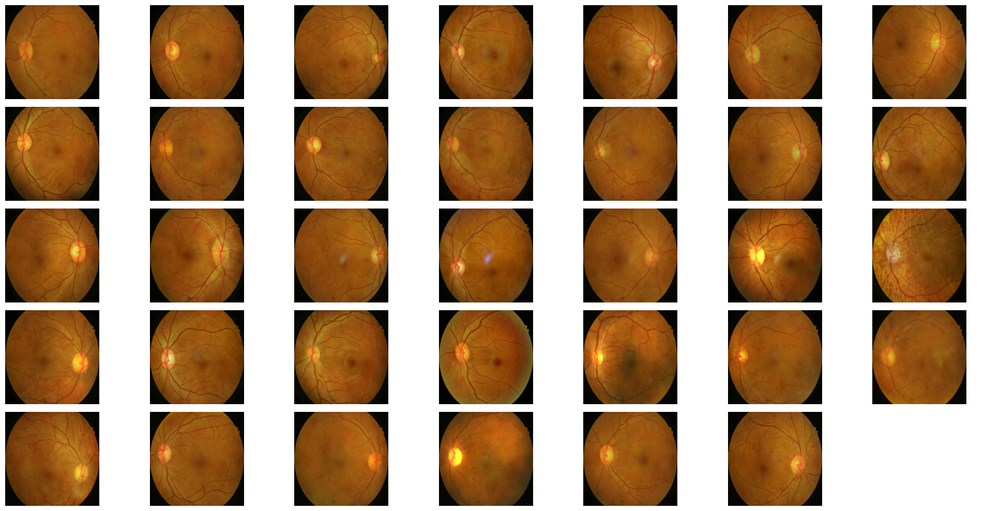

In [ ]:
#save_dir_normal2 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TESTING/NORMAL/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_normal2):
#    os.makedirs(save_dir_normal2)

f, axes = plt.subplots(nrows=5, ncols=7, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid7 = []
PSNR_idrid7 = []
for i, idrid7 in enumerate(idrid_grading_test_normal):
  idrid = crop_img(idrid7)
  idrid72 = cv2.resize(idrid, (512,512))
  idrid73 = color_norm(idrid72)
  idrid74 = contrast_enhance(idrid73)
  idrid75 = cv2.medianBlur(idrid74,3)

  # Convert numpy array to image object
  idrid76 = Image.fromarray(idrid75)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_test_normal.files[i])
  #save_path_normal2 = os.path.join(save_dir_normal2, filename)
  #idrid76.save(save_path_normal2, optimize=True, quality=90)

  MSE_idrid7.append(mean_squared_error(idrid72, idrid75))
  PSNR_idrid7.append(peak_signal_noise_ratio(idrid72, idrid75))

  axes[i].imshow(idrid75)
plt.tight_layout()

df7 = DataFrame({'MSE' :MSE_idrid7,
                'PSNR':PSNR_idrid7})

mean_mse71 = df7['MSE'].mean()
mean_psnr71 = df7['PSNR'].mean()

df7.loc[len(df7.index)] = [mean_mse71, mean_psnr71]

df7

**Mild**

,MSE,PSNR
0,89.668861,28.604387
1,55.814440,30.663338
2,48.897044,31.237978
3,54.007778,30.806240
4,90.527637,28.562992
5,67.783152,29.974987


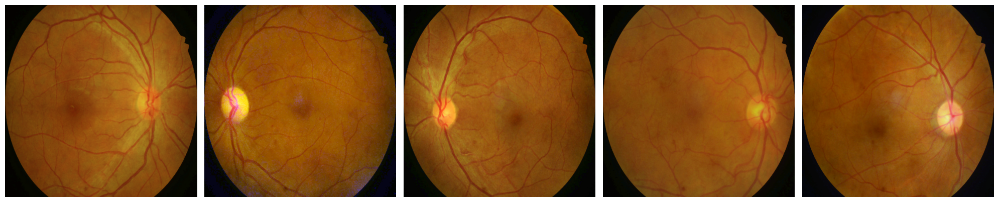

In [ ]:
#save_dir_mild2 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TESTING/MILD/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_mild2):
#    os.makedirs(save_dir_mild2)

f, axes = plt.subplots(nrows=1, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid8 = []
PSNR_idrid8 = []
for i, idrid8 in enumerate(idrid_grading_test_mild):
  idrid = crop_img(idrid8)
  idrid82 = cv2.resize(idrid, (512,512))
  idrid83 = color_norm(idrid82)
  idrid84 = contrast_enhance(idrid83)
  idrid85 = cv2.medianBlur(idrid84,3)

  # Convert numpy array to image object
  idrid86 = Image.fromarray(idrid85)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_test_mild.files[i])
  #save_path_mild2 = os.path.join(save_dir_mild2, filename)
  #idrid86.save(save_path_mild2, optimize=True, quality=90)

  MSE_idrid8.append(mean_squared_error(idrid82, idrid85))
  PSNR_idrid8.append(peak_signal_noise_ratio(idrid82, idrid85))

  axes[i].imshow(idrid85)
plt.tight_layout()

df8 = DataFrame({'MSE' :MSE_idrid8,
                'PSNR':PSNR_idrid8})

mean_mse81 = df8['MSE'].mean()
mean_psnr81 = df8['PSNR'].mean()

df8.loc[len(df8.index)] = [mean_mse81, mean_psnr81]

df8

**Moderate**

,MSE,PSNR
0,90.851212,28.547496
1,74.509566,29.408683
2,72.601336,29.521357
3,97.489440,28.241228
4,45.854734,31.516962
5,67.266836,29.852794
6,99.820357,28.138612
7,102.253173,28.034036
8,83.459623,28.916039
9,83.951235,28.890533


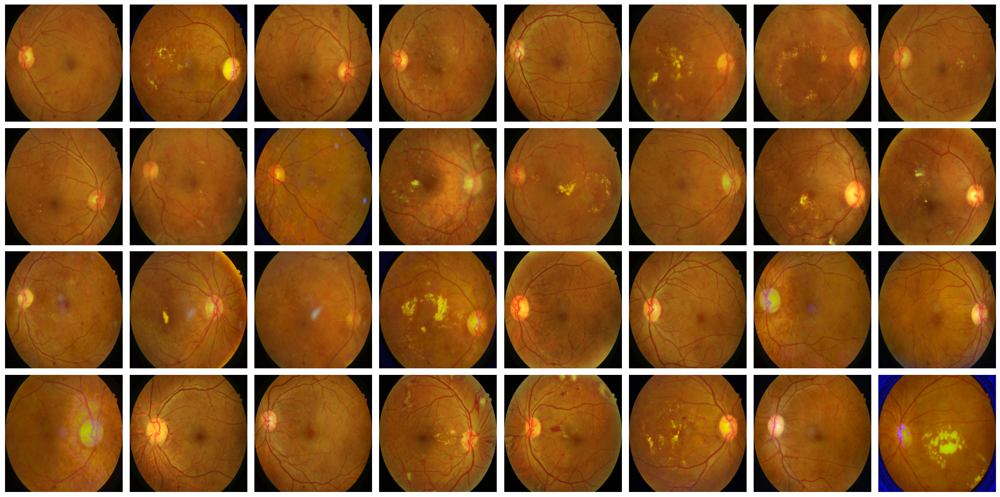

In [ ]:
#save_dir_mod2 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TESTING/MODERATE/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_mod2):
#    os.makedirs(save_dir_mod2)

f, axes = plt.subplots(nrows=4, ncols=8, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid9 = []
PSNR_idrid9 = []
for i, idrid9 in enumerate(idrid_grading_test_moderate):
  idrid = crop_img(idrid9)
  idrid92 = cv2.resize(idrid, (512,512))
  idrid93 = color_norm(idrid92)
  idrid94 = contrast_enhance(idrid93)
  idrid95 = cv2.medianBlur(idrid94,3)

  # Convert numpy array to image object
  idrid96 = Image.fromarray(idrid95)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_test_moderate.files[i])
  #save_path_mod2 = os.path.join(save_dir_mod2, filename)
  #idrid96.save(save_path_mod2, optimize=True, quality=90)

  MSE_idrid9.append(mean_squared_error(idrid92, idrid95))
  PSNR_idrid9.append(peak_signal_noise_ratio(idrid92, idrid95))

  axes[i].imshow(idrid95)
plt.tight_layout()

df9 = DataFrame({'MSE' :MSE_idrid9,
                'PSNR':PSNR_idrid9})

mean_mse91 = df9['MSE'].mean()
mean_psnr91 = df9['PSNR'].mean()

df9.loc[len(df9.index)] = [mean_mse91, mean_psnr91]

df9

**Severe**

,MSE,PSNR
0,71.439098,29.591444
1,85.124256,28.830270
2,80.511079,29.072247
3,89.039853,28.634959
4,89.934209,28.591554
5,97.306909,28.249367
6,72.169604,29.547260
7,75.841908,29.331711
8,71.959525,29.559921
9,76.173599,29.312759


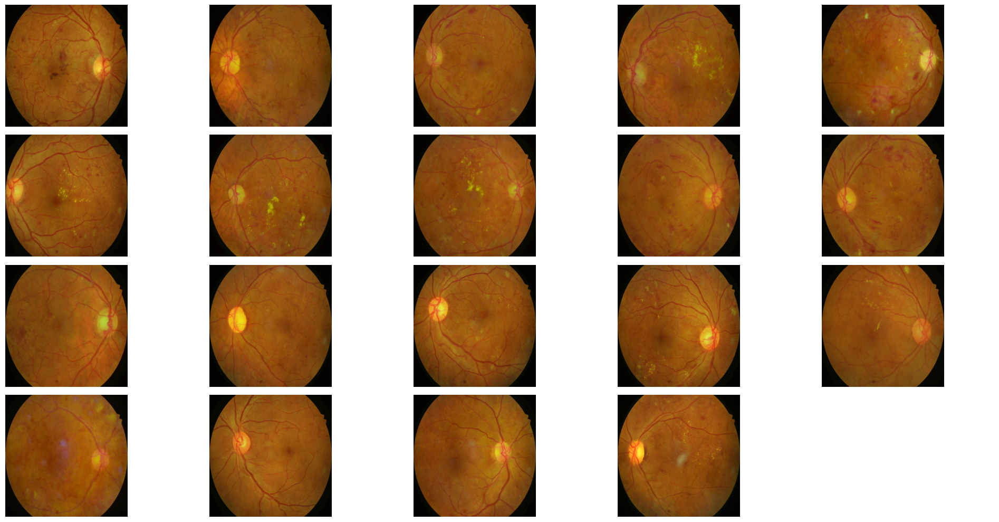

In [ ]:
#save_dir_svr2 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TESTING/SEVERE/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_svr2):
#    os.makedirs(save_dir_svr2)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid10 = []
PSNR_idrid10 = []
for i, idrid10 in enumerate(idrid_grading_test_severe):
  idrid = crop_img(idrid10)
  idrid102 = cv2.resize(idrid, (512,512))
  idrid103 = color_norm(idrid102)
  idrid104 = contrast_enhance(idrid103)
  idrid105 = cv2.medianBlur(idrid104,3)

  # Convert numpy array to image object
  idrid106 = Image.fromarray(idrid105)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_test_severe.files[i])
  #save_path_svr2 = os.path.join(save_dir_svr2, filename)
  #idrid106.save(save_path_svr2, optimize=True, quality=90)

  MSE_idrid10.append(mean_squared_error(idrid102, idrid105))
  PSNR_idrid10.append(peak_signal_noise_ratio(idrid102, idrid105))

  axes[i].imshow(idrid105)
plt.tight_layout()

df10 = DataFrame({'MSE' :MSE_idrid10,
                'PSNR':PSNR_idrid10})

mean_mse101 = df10['MSE'].mean()
mean_psnr101 = df10['PSNR'].mean()

df10.loc[len(df10.index)] = [mean_mse101, mean_psnr101]

df10

**PDR**

,MSE,PSNR
0,89.456329,28.614693
1,89.313690,28.621623
2,61.608501,30.234397
3,51.941751,30.975638
4,90.662477,28.556528
5,45.644927,31.536878
6,62.008587,30.206285
7,109.333639,27.743266
8,73.575916,29.463447
9,44.909148,31.607455


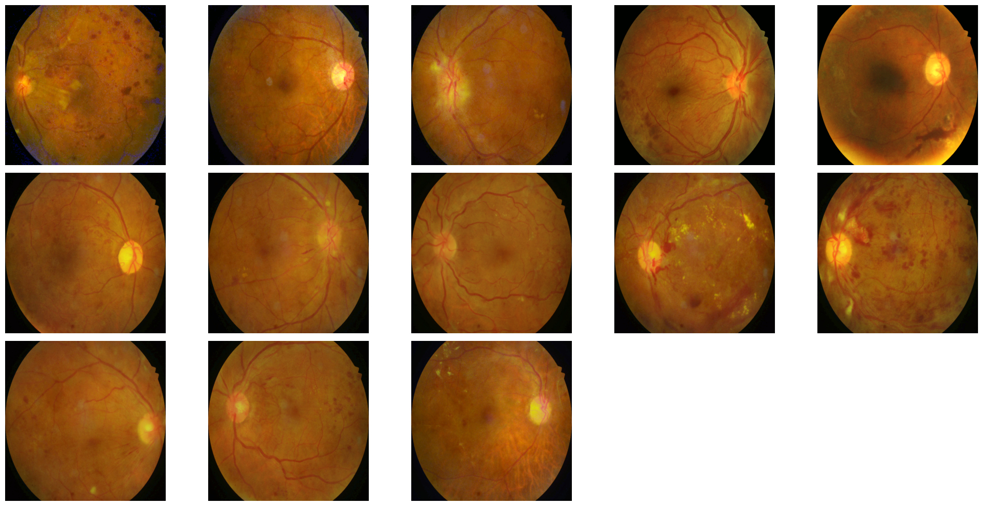

In [ ]:
#save_dir_pdr2 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/GRADING/TESTING/PDR/'
# Create the directory if it doesn't exist
#if not os.path.exists(save_dir_pdr2):
#    os.makedirs(save_dir_pdr2)

f, axes = plt.subplots(nrows=3, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_idrid11 = []
PSNR_idrid11 = []
for i, idrid11 in enumerate(idrid_grading_test_pdr):
  idrid = crop_img(idrid11)
  idrid112 = cv2.resize(idrid, (512,512))
  idrid113 = color_norm(idrid112)
  idrid114 = contrast_enhance(idrid113)
  idrid115 = cv2.medianBlur(idrid114,3)

  # Convert numpy array to image object
  idrid116 = Image.fromarray(idrid115)

  # Save the processed image with the original file name
  filename = os.path.basename(idrid_grading_test_pdr.files[i])
  #save_path_pdr2 = os.path.join(save_dir_pdr2, filename)
  #idrid116.save(save_path_pdr2, optimize=True, quality=90)

  MSE_idrid11.append(mean_squared_error(idrid112, idrid115))
  PSNR_idrid11.append(peak_signal_noise_ratio(idrid112, idrid115))

  axes[i].imshow(idrid115)
plt.tight_layout()

df11 = DataFrame({'MSE' :MSE_idrid11,
                'PSNR':PSNR_idrid11})

mean_mse111 = df11['MSE'].mean()
mean_psnr111 = df11['PSNR'].mean()

df11.loc[len(df11.index)] = [mean_mse111, mean_psnr111]

df11

In [ ]:
#@title
#groundtruth
idrid_gt_train_MA = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TRAINING SET/MA/*')
idrid_gt_train_HM = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TRAINING SET/HM/*')
idrid_gt_train_HE = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TRAINING SET/HARD EX/*')
idrid_gt_train_SE = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TRAINING SET/SOFT EX/*')

idrid_gt_test_MA = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TESTING SET/MA/*')
idrid_gt_test_HM = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TESTING SET/HM/*')
idrid_gt_test_HE = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TESTING SET/HARD EX/*')
idrid_gt_test_SE = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/IDRID/SEGMENTASI/GROUNDTRUTHS/TESTING SET/SOFT EX/*')

In [ ]:
#@title
from PIL import Image
import numpy as np
from skimage.filters import threshold_otsu

def binarize_image(gt_image):
    # Convert the numpy array to a PIL Image object
    gt_image = Image.fromarray(gt_image)

    # Convert the image to grayscale
    gt_gray = gt_image.convert('L')

    # Convert the grayscale PIL Image to a NumPy array
    gt_array = np.array(gt_gray)

    # Apply Otsu's method to obtain a threshold value
    threshold_value = threshold_otsu(gt_array)

    # Binarize the image using the threshold value
    binary_image = gt_gray.point(lambda x: 0 if x/255 < threshold_value/255 else 1, '1')

    return binary_image

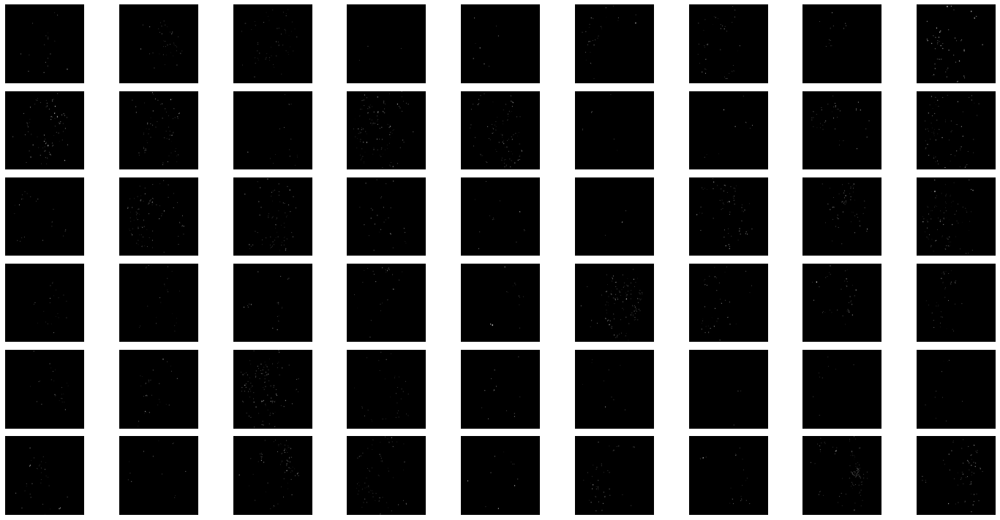

In [ ]:
#@title
save_dir1 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/SEGMENTASI/TRAINING GT/MA/'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir1):
    os.makedirs(save_dir1)

f, axes = plt.subplots(nrows=6, ncols=9, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gt in enumerate(idrid_gt_train_MA):
    gt11 = cv2.resize(gt,(512,512))
    gt12 = binarize_image(gt11)

    # Save the binarized image with the original file name
    filename = os.path.basename(idrid_gt_train_MA.files[i])
    save_path1 = os.path.join(save_dir1, filename)
    gt12.save(save_path1)

    axes[i].imshow(gt12)
plt.tight_layout()

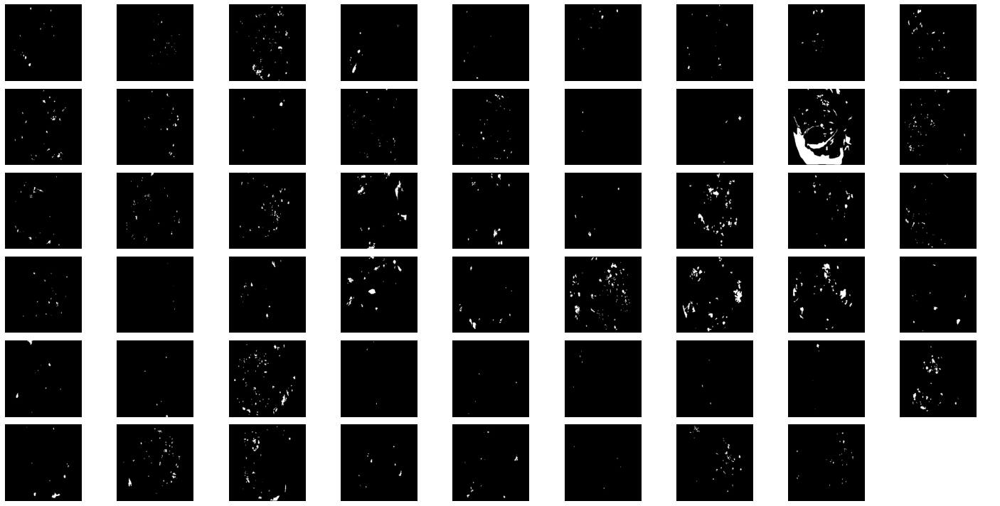

In [ ]:
#@title
save_dir2 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/SEGMENTASI/TRAINING GT/HM/'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir2):
    os.makedirs(save_dir2)

f, axes = plt.subplots(nrows=6, ncols=9, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gt2 in enumerate(idrid_gt_train_HM):
    gt21 = cv2.resize(gt2,(512,512))
    gt22 = binarize_image(gt21)

    # Save the binarized image with the original file name
    filename = os.path.basename(idrid_gt_train_HM.files[i])
    save_path2 = os.path.join(save_dir2, filename)
    gt22.save(save_path2)

    axes[i].imshow(gt22)
plt.tight_layout()

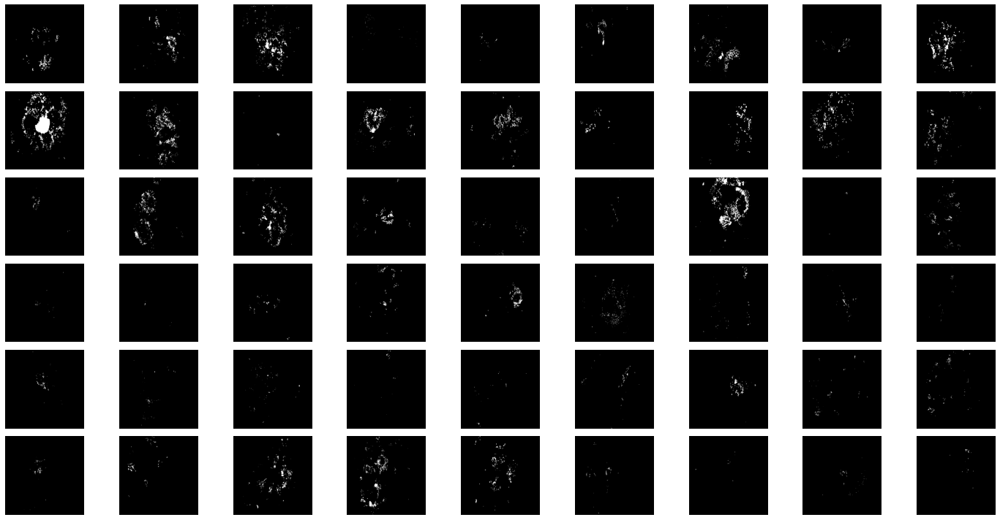

In [ ]:
#@title
save_dir3 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/SEGMENTASI/TRAINING GT/HARD EX/'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir3):
    os.makedirs(save_dir3)

f, axes = plt.subplots(nrows=6, ncols=9, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gt3 in enumerate(idrid_gt_train_HE):
    gt31 = cv2.resize(gt3,(512,512))
    gt32 = binarize_image(gt31)

    # Save the binarized image with the original file name
    filename = os.path.basename(idrid_gt_train_HE.files[i])
    save_path3 = os.path.join(save_dir3, filename)
    gt32.save(save_path3)

    axes[i].imshow(gt32)
plt.tight_layout()

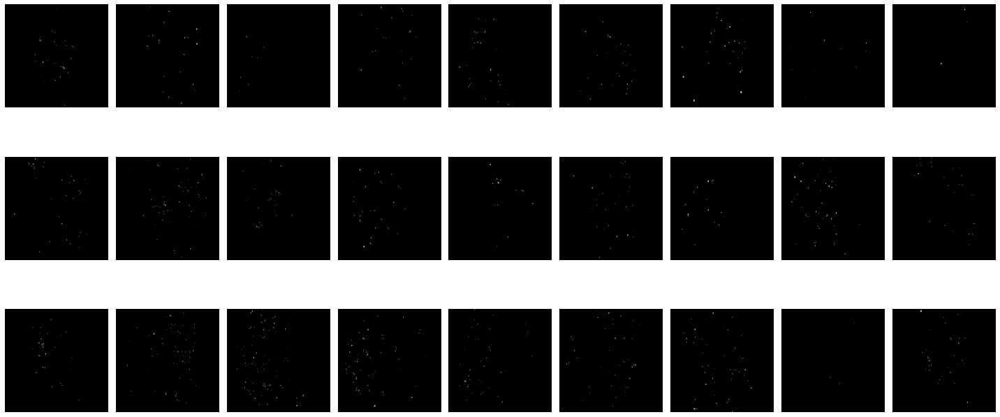

In [ ]:
#@title
save_dir5 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/SEGMENTASI/TESTING GT/MA/'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir5):
    os.makedirs(save_dir5)

f, axes = plt.subplots(nrows=3, ncols=9, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gt5 in enumerate(idrid_gt_test_MA):
    gt51 = cv2.resize(gt5,(512,512))
    gt52 = binarize_image(gt51)

    # Save the binarized image with the original file name
    filename = os.path.basename(idrid_gt_test_MA.files[i])
    save_path5 = os.path.join(save_dir5, filename)
    gt52.save(save_path5)

    axes[i].imshow(gt52)
plt.tight_layout()

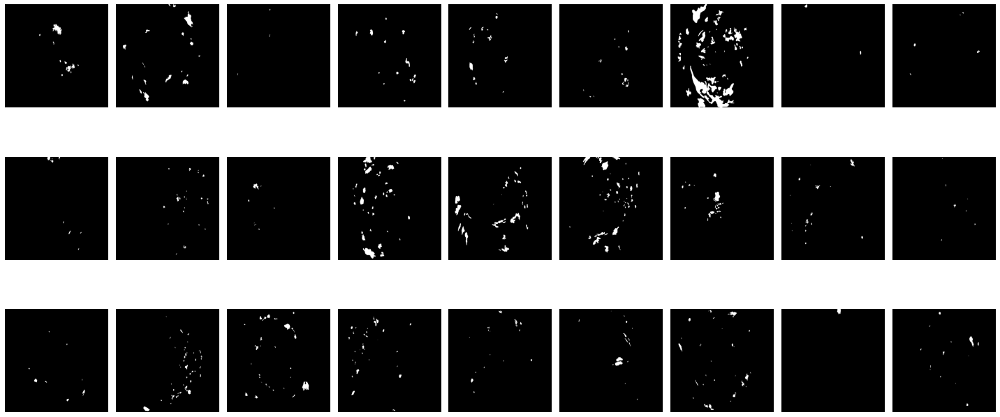

In [ ]:
#@title
save_dir6 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/SEGMENTASI/TESTING GT/HM/'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir6):
    os.makedirs(save_dir6)

f, axes = plt.subplots(nrows=3, ncols=9, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gt6 in enumerate(idrid_gt_test_HM):
    gt61 = cv2.resize(gt6,(512,512))
    gt62 = binarize_image(gt61)

    # Save the binarized image with the original file name
    filename = os.path.basename(idrid_gt_test_HM.files[i])
    save_path6 = os.path.join(save_dir6, filename)
    gt62.save(save_path6)

    axes[i].imshow(gt62)
plt.tight_layout()

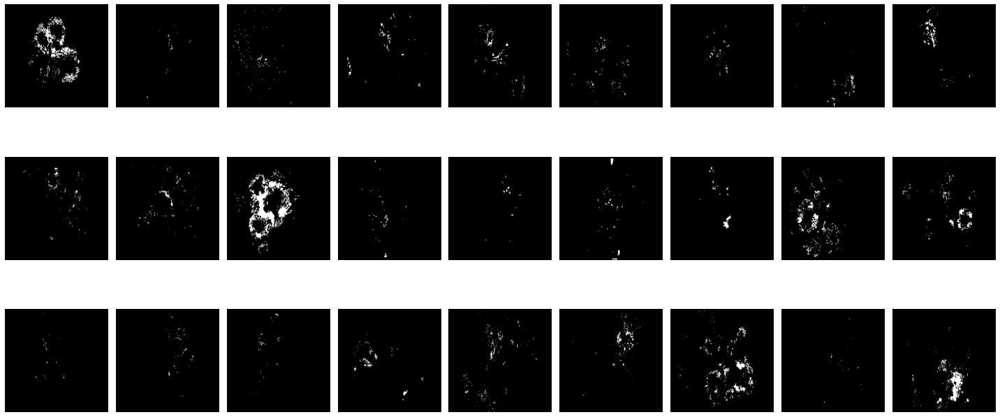

In [ ]:
#@title
save_dir7 = 'drive/My Drive/Tugas Akhir/DATASETS/IDRID PREPROCESS/SEGMENTASI/TESTING GT/HARD EX/'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir7):
    os.makedirs(save_dir7)

f, axes = plt.subplots(nrows=3, ncols=9, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gt7 in enumerate(idrid_gt_test_HE):
    gt71 = cv2.resize(gt7,(512,512))
    gt72 = binarize_image(gt71)

    # Save the binarized image with the original file name
    filename = os.path.basename(idrid_gt_test_HE.files[i])
    save_path7 = os.path.join(save_dir7, filename)
    gt72.save(save_path7)

    axes[i].imshow(gt72)
plt.tight_layout()

In [ ]:
#@title
drive_segment_train = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/DRIVE/TRAINING SET/ORIGINAL/*')
drive_segment_test = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/DRIVE/TESTING SET/ORIGINAL/*')

drive_gt_train = io.ImageCollection('drive/MyDrive/Tugas Akhir/DATASETS/DRIVE/TRAINING SET/1st_manual/*')
drive_gt_test = io.ImageCollection('drive/MyDrive/Tugas Akhir/DATASETS/DRIVE/TESTING SET/1st_manual/*')
#drive_mask_train = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/DRIVE/TRAINING SET/MASK/*')
#drive_mask_test = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/DRIVE/TESTING SET/MASK/*')

stare_segment_train = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/STARE/IMAGES/*')
stare_gt_train = io.ImageCollection('drive/My Drive/Tugas Akhir/DATASETS/STARE/LABELS/*')

In [ ]:
#@title
#khusus stare
def normalize_img2(image):
    # convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # normalize the pixel intensities to be between 0 and 1
    normalized_img2 = gray / 255.0

    return normalized_img2

def crop_img2(image):
    # normalize the image pixel intensities
    normalized_img2 = normalize_img2(image)

    # apply thresholding to the normalized image
    threshold_value = 0.2
    _, mask = cv2.threshold(normalized_img2, threshold_value, 1, cv2.THRESH_BINARY)

    # find the coordinates of the non-zero elements in the mask
    coords = np.argwhere(mask)

    # find the smallest and largest coordinates in each dimension
    x = np.min(coords, axis=0)
    y = np.max(coords, axis=0) + 1

    # crop the image based on the smallest and largest coordinates
    cropped_img2 = image[x[0]:y[0], x[1]:y[1]]

    return cropped_img2

,MSE,PSNR
0,84.207640,28.877289
1,60.395097,30.320787
2,90.311291,28.573383
3,85.063847,28.833353
4,59.524175,30.383870
5,96.504583,28.285324
6,88.287085,28.671832
7,67.202792,29.856930
8,85.060623,28.833518
9,95.937021,28.310941


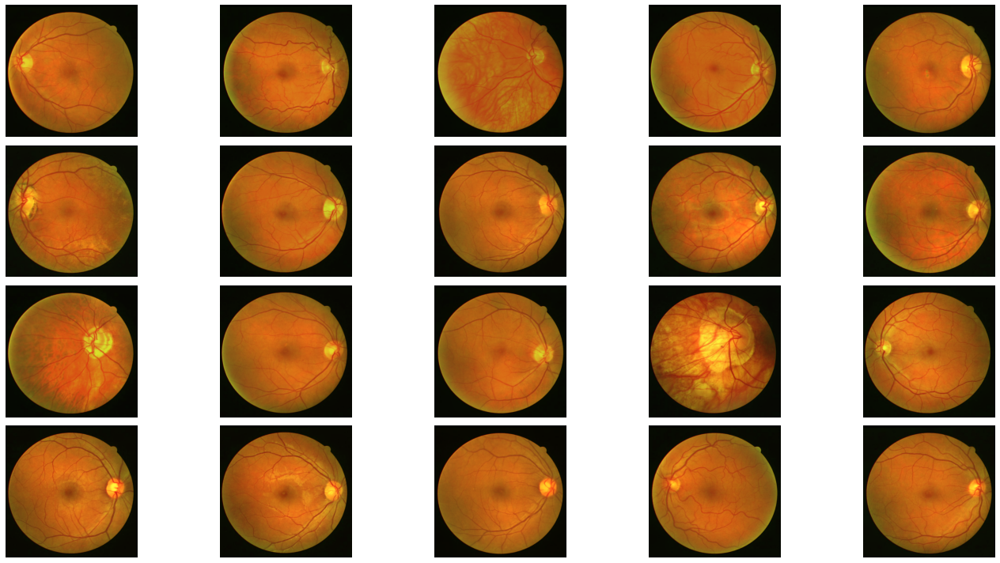

In [ ]:
#@title
save_dir_drivetr = '/content/drive/MyDrive/Tugas Akhir/DATASETS/DRIVE PREPROCESS/TRAINING IMAGE2'
# Create the directory if it doesn't exist
if not os.path.exists(save_dir_drivetr):
    os.makedirs(save_dir_drivetr)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_drive = []
PSNR_drive = []
for i, drive in enumerate(drive_segment_train):
  drive2 = cv2.resize(drive, (512,512))
  drive3 = color_norm(drive2)
  drive4 = contrast_enhance(drive3)
  drive5 = cv2.medianBlur(drive4,3)

  # Convert numpy array to image object
  drive6 = Image.fromarray(drive5)

  MSE_drive.append(mean_squared_error(drive2, drive5))
  PSNR_drive.append(peak_signal_noise_ratio(drive2, drive5))

  # Save the processed image with the original file name
  filename = os.path.basename(drive_segment_train.files[i])
  save_path_drivetr = os.path.join(save_dir_drivetr, filename)
  drive6.save(save_path_drivetr)

  axes[i].imshow(drive5)
plt.tight_layout()

df12 = DataFrame({'MSE' :MSE_drive,
                'PSNR':PSNR_drive})

mean_mse12 = df12['MSE'].mean()
mean_psnr12 = df12['PSNR'].mean()

df12.loc[len(df12.index)] = [mean_mse12, mean_psnr12]

df12

In [ ]:
#@title
save_dir_drivetest = '/content/drive/MyDrive/Tugas Akhir/DATASETS/DRIVE PREPROCESS/TESTING IMAGE2'
# Create the directory if it doesn't exist
if not os.path.exists(save_dir_drivetest):
    os.makedirs(save_dir_drivetest)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_drive2 = []
PSNR_drive2 = []
for i, drive2 in enumerate(drive_segment_test):
  drive22 = cv2.resize(drive2, (512,512))
  drive23 = color_norm(drive22)
  drive24 = contrast_enhance(drive23)
  drive25 = cv2.medianBlur(drive24,3)

  # Convert numpy array to image object
  drive26 = Image.fromarray(drive25)

  MSE_drive2.append(mean_squared_error(drive22, drive25))
  PSNR_drive2.append(peak_signal_noise_ratio(drive22, drive25))

  # Save the processed image with the original file name
  filename = os.path.basename(drive_segment_test.files[i])
  save_path_drivetest = os.path.join(save_dir_drivetest, filename)
  drive26.save(save_path_drivetest)

  axes[i].imshow(drive25)
plt.tight_layout()

df13 = DataFrame({'MSE' :MSE_drive2,
                'PSNR':PSNR_drive2})

mean_mse22 = df13['MSE'].mean()
mean_psnr22 = df13['PSNR'].mean()

df13.loc[len(df13.index)] = [mean_mse22, mean_psnr22]

df13

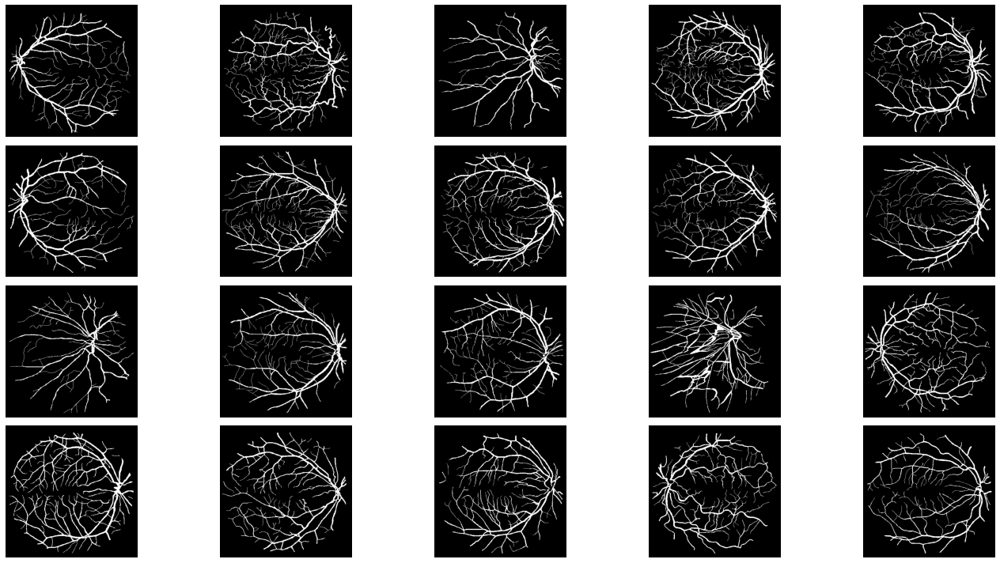

In [ ]:
#@title
save_dir_gtdrive = '/content/drive/MyDrive/Tugas Akhir/DATASETS/DRIVE PREPROCESS/TRAINING/GROUNDTRUTH'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir_gtdrive):
    os.makedirs(save_dir_gtdrive)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gtdrive in enumerate(drive_gt_train):
    gtdrive1 = cv2.resize(gtdrive,(512,512))
    gtdrive2 = binarize_image(gtdrive1)

    # Save the binarized image with the original file name
    filename = os.path.basename(drive_gt_train.files[i])
    save_path_gtdrive = os.path.join(save_dir_gtdrive, filename)
    gtdrive2.save(save_path_gtdrive)

    axes[i].imshow(gtdrive2)
plt.tight_layout()

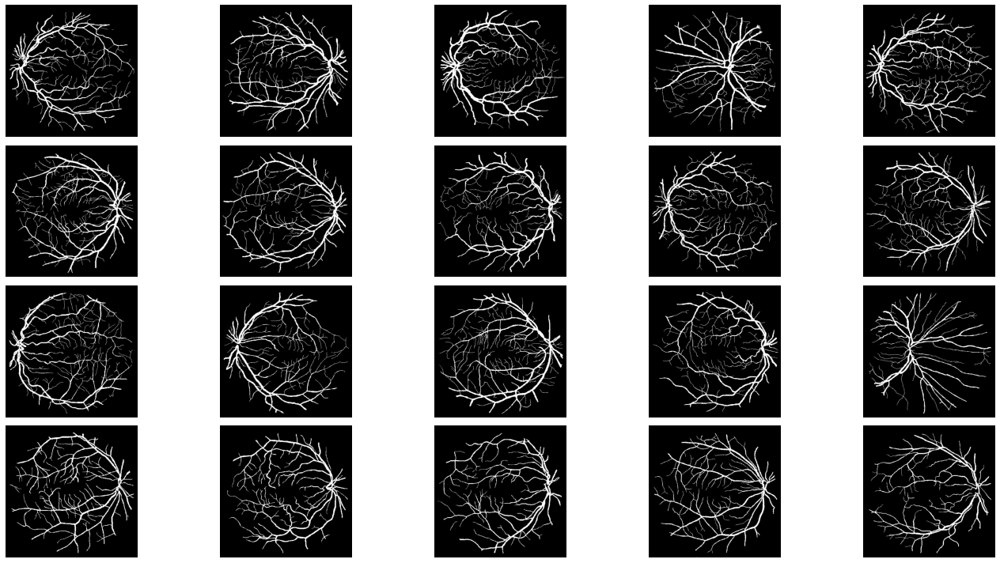

In [ ]:
#@title
save_dir_gtdrive1 = '/content/drive/MyDrive/Tugas Akhir/DATASETS/DRIVE PREPROCESS/TESTING/GROUNDTRUTH'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir_gtdrive1):
    os.makedirs(save_dir_gtdrive1)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gtdrive1 in enumerate(drive_gt_test):
    gtdrive11 = cv2.resize(gtdrive1,(512,512))
    gtdrive21 = binarize_image(gtdrive11)

    # Save the binarized image with the original file name
    filename = os.path.basename(drive_gt_test.files[i])
    save_path_gtdrive1 = os.path.join(save_dir_gtdrive1, filename)
    gtdrive21.save(save_path_gtdrive1)

    axes[i].imshow(gtdrive21)
plt.tight_layout()

In [ ]:
#@title
save_dir_stare = '/content/drive/MyDrive/Tugas Akhir/DATASETS/STARE PREPROCESS/IMAGE'
# Create the directory if it doesn't exist
if not os.path.exists(save_dir_stare):
    os.makedirs(save_dir_stare)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

MSE_stare = []
PSNR_stare = []
for i, stare in enumerate(stare_segment_train):
  stare2 = cv2.resize(stare, (512,512))
  stare3 = color_norm(stare2)
  stare4 = contrast_enhance(stare3)
  stare5 = cv2.medianBlur(stare4,3)

  # Convert numpy array to image object
  stare6 = Image.fromarray(stare5)

  MSE_stare.append(mean_squared_error(stare2, stare5))
  PSNR_stare.append(peak_signal_noise_ratio(stare2, stare5))

  # Save the processed image with the original file name
  filename = os.path.basename(stare_segment_train.files[i])
  save_path_stare = os.path.join(save_dir_stare, filename)
  stare6.save(save_path_stare)

  axes[i].imshow(stare5)
plt.tight_layout()

df14 = DataFrame({'MSE' :MSE_stare,
                'PSNR':PSNR_stare})

mean_mse32 = df14['MSE'].mean()
mean_psnr32 = df14['PSNR'].mean()

df14.loc[len(df14.index)] = [mean_mse32, mean_psnr32]

df14

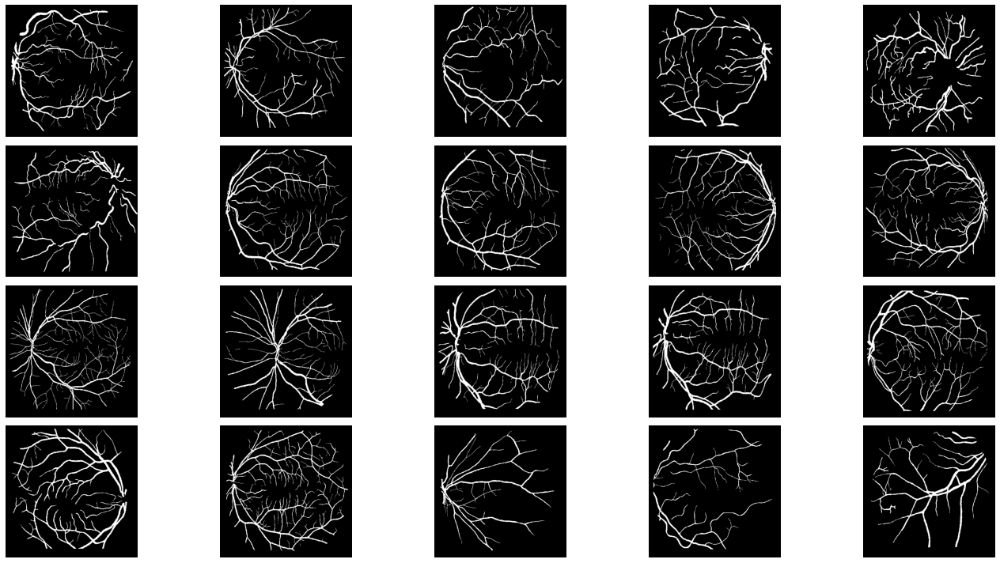

In [ ]:
#@title
save_dir_staregt = '/content/drive/MyDrive/Tugas Akhir/DATASETS/STARE PREPROCESS/GROUNDTRUTH'

# Create the directory if it doesn't exist
if not os.path.exists(save_dir_staregt):
    os.makedirs(save_dir_staregt)

f, axes = plt.subplots(nrows=4, ncols=5, figsize=(20,10))
axes = axes.ravel()
for ax in axes:
    ax.axis('off')

for i, gtstare in enumerate(stare_gt_train):
    gtstare1 = cv2.resize(gtstare,(512,512))
    gtstare2 = binarize_image(gtstare1)

    # Save the binarized image with the original file name
    filename = os.path.basename(stare_gt_train.files[i])
    save_path_staregt = os.path.join(save_dir_staregt, filename)
    gtstare2.save(save_path_staregt)

    axes[i].imshow(gtstare2)
plt.tight_layout()